In [1]:
# The code was removed by Watson Studio for sharing.

# The Battle of Neighborhoods

Coursera - Applied Data Science Capstone by IBM

<a href='https://eu-gb.dataplatform.cloud.ibm.com/analytics/notebooks/v2/ee6f98b8-a98a-4841-901f-bf22b7ff8e87/view?access_token=0f504462b091625446859cb2ad91066efe5f80f4e6f5349aa763851d42f73a3b'>Notebook Link</a> on Watson in order to see maps

## Table Of Contents

- [Introduction & Business Problem](#introduction)
    - [Background](#background)
    - [Problem Statement](#problem)
    - [Target Audience](#audience)
- [Data](#data)
    - [Dataset 1: Toronto Neighbourhoods](#dataset1)
    - [Dataset 2: Toronto Demographics](#dataset2)
    - [Dataset 3: List of Places in Toronto](#dataset3)
- [Methodology](#methodology)
    - [Notebook Setup](#setup)
    - [Toronto Coordinates](#toronto_coordinates)
    - [Toronto Neighbourhoods](#toronto_neighbourhoods)
    - [Toronto Demographics](#toronto_demographics)
    - [Foursquare Credentials](#foursquare_credentials)
    - [Places using Foursquare API](#foursquare)
        - [Fetch Venues](#fs_fetch_venues_fn)
        - [Yoga Studios & Gyms](#fs_studios)
        - [Nearby Venues](#fs_venues)
    - [Clustering](#clustering)
        - [Similar Neighbourhoods For Studios](#cl_studios)
        - [Similar Neighbourhoods For Venues](#cl_venues)
        - [Similar Neighbourhoods For Studios and Venues Combined](#cl_combined)
- [Results](#results)
- [Discussion](#discussion)
- [Conclusion](#conclusion)

## Introduction & Business Problem <a name="introduction"></a>

### Background <a name='background'></a>

Toronto is the largest and the most populous city in Canada. It is an international centre of business, finance, arts, and culture, and is recognized as one of the most multicultural and cosmopolitan cities in the world. The diverse population of Toronto reflects its current and historical role as an important destination for immigrants to Canada. Over 200 distinct ethnic origins are represented among its inhabitants and while the majority of population speak English as their primary language, over 160 languages are spoken in the city.

Given the population and diversity of Toronto, the market is mostly saturated and leads to a competitive environment for business owners. Starting a new business will be more successful if extensive analysis is done in a structured manner and insights will help to choose the right business model and structure.

### Problem Statement <a name='problem'></a>

In a city as diverse and developed like Toronto, opening a yoga studio is an exciting but also an exhausting task. Once decided, the next step should be finding an ideal location for the studio. Multiple factors are needed to be analysed for the best location which include but not limited to:
- Style of operation
- Demographics
- Foot traffic
- Competition

It's crucial to find the best location for a yoga studio and if successful same recommendations can be used to expand into other neighbourhoods of Toronto.


### Target Audience <a name='audience'></a>

The research is going to be interested by anyone who is planning to open a yoga studio in Toronto. Goal is to identify and recommend which neighbourhood(s) should be the targeted to open a yoga studio.

## Data <a name="data"></a>

Multiple datasets will be used for analysing city of Toronto and the best neighbourhood for opening a yoga studio.

#### Dataset 1: Toronto Neighbourhoods <a name='dataset1'></a>

A list boroughs and neighbourhoods of Toronto is essential in order to analyse the neighbourhoods. This dataset will be used to capture the coordinates of specific neighbourhoods.

Dataset is available on Toronto Open Data website at https://open.toronto.ca/dataset/neighbourhoods/. CSV file can be found at https://ckan0.cf.opendata.inter.prod-toronto.ca/download_resource/a083c865-6d60-4d1d-b6c6-b0c8a85f9c15?format=csv&projection=4326.

#### Dataset 2: Toronto Demographics <a name='dataset2'></a>

Capturing neighbourhoods and their demographics are critical. Multiple factors will be included in the analysis, such as population, density, average income. Demographics dataset will be enriched with Toronto neighbourhoods for further insights.

Dataset is available on Wikipedia at https://en.wikipedia.org/wiki/Demographics_of_Toronto_neighbourhoods.

#### Dataset 3: List of Places in Toronto <a name='dataset3'></a>

Places dataset will be used to cluster neighbourhoods in Toronto based on the similarity / relevance of places. List of yoga studios and gym will enable untapped markets and set of specific categories such as residences, professional services, and shops will be used to identify the similarity of the neighbourhoods.

*Foursquare Places API* will be used to capture places. More information can be found at https://developer.foursquare.com/docs/api. 

## Methodology <a name="methodology"></a>

### Notebook Setup <a name='setup'></a>

In [2]:
try:
    import numpy as np
    import pandas as pd
    import re
    import requests
    import matplotlib.pyplot as plt
    import matplotlib.cm as cm
    import matplotlib.colors as colors
    import six
    from sklearn.cluster import KMeans
    from scipy.spatial.distance import cdist
    try:
        from bs4 import BeautifulSoup as bts
    except:
        !conda install -c conda-forge beautifulsoup4 --yes
        from bs4 import BeautifulSoup as bts
    try:
        from geopy.geocoders import Nominatim
    except:
        !conda install -c conda-forge geopy --yes
        from geopy.geocoders import Nominatim
    try:
        import folium
    except:
        !conda install -c conda-forge folium --yes
        import folium
    print('All libraries imported successfully')
except:
    print('ERROR: Could not import all libraries')
    
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

All libraries imported successfully


### Define Toronto Coordinates <a name='toronto_coordinates'></a>

In [3]:
def getTorontoCoords(): # use Nominatim to get Toronto's coordinates
    geolocator = Nominatim(user_agent="toronto")
    location = geolocator.geocode('Toronto, Ontario')
    lat_offset = 0.05 # tiny bit offset for better map visibility
    return [location.latitude+lat_offset, location.longitude]
    
toronto_location = getTorontoCoords()

### Toronto Neighbourhoods <a name='toronto_neighbourhoods'></a>

Finding the neighbourhoods of Toronto using Toronto Open Data and then visualize on a map.

In [4]:
uri = 'https://ckan0.cf.opendata.inter.prod-toronto.ca/download_resource/a083c865-6d60-4d1d-b6c6-b0c8a85f9c15?format=csv&projection=4326'
toronto_coordinates_data = pd.read_csv(uri)
toronto_coordinates_data['AREA_NAME'] = toronto_coordinates_data['AREA_NAME'].apply(lambda x: x[0:x.find('(')-1])
toronto_coordinates_data = toronto_coordinates_data[['AREA_NAME','LATITUDE','LONGITUDE','geometry']]
toronto_coordinates_data.rename({'AREA_NAME':'Neighbourhood','LATITUDE':'Lat','LONGITUDE':'Lng'}, axis=1, inplace=True)
toronto_coordinates_data.head()

,Neighbourhood,Lat,Lng,geometry
0,Wychwood,43.676919,-79.425515,"{u'type': u'Polygon', u'coordinates': (((-79.4..."
1,Yonge-Eglinton,43.704689,-79.403590,"{u'type': u'Polygon', u'coordinates': (((-79.4..."
2,Yonge-St.Clair,43.687859,-79.397871,"{u'type': u'Polygon', u'coordinates': (((-79.3..."
3,York University Heights,43.765736,-79.488883,"{u'type': u'Polygon', u'coordinates': (((-79.5..."
4,Yorkdale-Glen Park,43.714672,-79.457108,"{u'type': u'Polygon', u'coordinates': (((-79.4..."


In [5]:
map_toronto = folium.Map(location=toronto_location, zoom_start=11)
for lat, lng, name in zip(toronto_coordinates_data['Lat'], toronto_coordinates_data['Lng'], toronto_coordinates_data['Neighbourhood']):
    label = folium.Popup('{}'.format(name), parse_html=True)
    folium.CircleMarker([lat, lng], radius=5, popup=label, color='blue', fill=True).add_to(map_toronto)
map_toronto

### Toronto Demographics <a name='toronto_demographics'></a>

Scraping demographics data from Wikipedia and enriching with Toronto neighbourhood coordinates dataset. Using BeautifulSoup to parse the page and extract the table from the page. After completion, data is enriched with coordinates and visualized on a map.

In [6]:
toronto_demographics_raw_data = requests.get('https://en.wikipedia.org/wiki/Demographics_of_Toronto_neighbourhoods').text
toronto_demographics_raw_data = bts(toronto_demographics_raw_data,'html.parser')

Once scraped, data needs to be cleaned and correct data types needs to be assigned accordingly.

In [7]:
def findFormerMunicipality(raw_data, fm): # find matching actual municipality name to replace acronyms
    for municipalities in raw_data.ul.findAll('li'):
        m = municipalities.text.split('-')[1]
        if m.split('(')[1].strip(')') == fm:
            return m.split('(')[0]
        
toronto_demographics_data = toronto_demographics_raw_data.findAll('table',class_="wikitable sortable")[0].findAll('tr')
columns = [th.text.strip('\n').replace('\xa0','') for th in toronto_demographics_data[0].findAll('th')]
rows = []
for tr in toronto_demographics_data[2:]:
    td = tr.find_all('td')
    row = [tr.text.strip('\n') for tr in td]
    rows.append(row)
toronto_demographics_data = pd.DataFrame(rows, columns=columns)
toronto_demographics_data['FM'] = toronto_demographics_data['FM'].apply(lambda x: findFormerMunicipality(toronto_demographics_raw_data, x))
toronto_demographics_data['Population'] = toronto_demographics_data['Population'].apply(lambda x: int(x.replace(',','')))
toronto_demographics_data['Land area (km2)'] = toronto_demographics_data['Land area (km2)'].apply(lambda x: float(x))
toronto_demographics_data['Density (people/km2)'] = toronto_demographics_data['Density (people/km2)'].apply(lambda x: int(x.replace(',','')))
toronto_demographics_data['% Change in Population since 2001'] = toronto_demographics_data['% Change in Population since 2001'].apply(lambda x: float(x))
toronto_demographics_data['Average Income'] = toronto_demographics_data['Average Income'].apply(lambda x: int(x.replace(',','')))
toronto_demographics_data['Transit Commuting%'] = toronto_demographics_data['Transit Commuting%'].apply(lambda x: float(x))
toronto_demographics_data['% Renters'] = toronto_demographics_data['% Renters'].apply(lambda x: float(x))
toronto_demographics_data['Second most common language (after English) by name'] = toronto_demographics_data['Second most common language (after English) by name'].apply(lambda x: x.split(' (')[0])
toronto_demographics_data['Second most common language (after English) by percentage'] = toronto_demographics_data['Second most common language (after English) by percentage'].apply(lambda x: float(x.split('%')[0]))
toronto_demographics_data.rename({'Name':'Neighbourhood','FM':'Borough'}, axis=1, inplace=True)
toronto_demographics_data.drop(['Census Tracts','Map'], axis=1, inplace=True)
toronto_demographics_data.head()

,Neighbourhood,Borough,Population,Land area (km2),Density (people/km2),% Change in Population since 2001,Average Income,Transit Commuting%,% Renters,Second most common language (after English) by name,Second most common language (after English) by percentage
0,Agincourt,Scarborough,44577,12.45,3580,4.6,25750,11.1,5.9,Cantonese,19.3
1,Alderwood,Etobicoke,11656,4.94,2360,-4.0,35239,8.8,8.5,Polish,6.2
2,Alexandra Park,Old City of Toronto,4355,0.32,13609,0.0,19687,13.8,28.0,Cantonese,17.9
3,Allenby,Old City of Toronto,2513,0.58,4333,-1.0,245592,5.2,3.4,Russian,1.4
4,Amesbury,North York,17318,3.51,4934,1.1,27546,16.4,19.7,Spanish,6.1


Neighbourhood names do not have an exact match between demographics and coordinates data. Hence performing a fuzzy search to approximate the coordinates and then removing unmatched data.

In [8]:
def getNeighbourhoodCoords(demog,l): # perform fuzzy search and approximate neighbourhood coordinates
    t = pd.DataFrame(columns=toronto_coordinates_data.columns)
    for d in re.split('/|-',demog['Neighbourhood']):
        x = toronto_coordinates_data[toronto_coordinates_data['Neighbourhood'].str.contains(d.strip(), regex=False)]
        t = t.append(x)
    try:
        return t.describe().loc[['mean'],[l]].values[0][0]
    except:
        return np.NaN

toronto_demographics_data['Lat'] = toronto_demographics_data.apply(lambda x: getNeighbourhoodCoords(x,'Lat'), axis=1)
toronto_demographics_data['Lng'] = toronto_demographics_data.apply(lambda x: getNeighbourhoodCoords(x,'Lng'), axis=1)
toronto_demographics_data = toronto_demographics_data[toronto_demographics_data['Lat'].notna()].reset_index()
toronto_demographics_data.head()

,index,Neighbourhood,Borough,Population,Land area (km2),Density (people/km2),% Change in Population since 2001,Average Income,Transit Commuting%,% Renters,Second most common language (after English) by name,Second most common language (after English) by percentage,Lat,Lng
0,0,Agincourt,Scarborough,44577,12.45,3580,4.6,25750,11.1,5.9,Cantonese,19.3,43.797049,-79.266162
1,1,Alderwood,Etobicoke,11656,4.94,2360,-4.0,35239,8.8,8.5,Polish,6.2,43.604937,-79.541611
2,4,Amesbury,North York,17318,3.51,4934,1.1,27546,16.4,19.7,Spanish,6.1,43.701326,-79.485589
3,6,Banbury,North York,6641,2.72,2442,5.0,92319,6.1,4.8,Unspecified Chinese,5.1,43.737657,-79.349718
4,7,Bathurst Manor,North York,14945,4.69,3187,12.3,34169,13.4,18.6,Russian,9.5,43.764813,-79.456055


In [9]:
map_toronto_revised = folium.Map(location=toronto_location, zoom_start=11)
for lat, lng, name in zip(toronto_demographics_data['Lat'], toronto_demographics_data['Lng'], toronto_demographics_data['Neighbourhood']):
    label = folium.Popup('{}'.format(name), parse_html=True)
    folium.CircleMarker([lat, lng], radius=5, popup=label, color='blue', fill=True).add_to(map_toronto_revised)
map_toronto_revised

### Define Foursquare Credentials <a name='foursquare_credentials'></a>

In [10]:
# The code was removed by Watson Studio for sharing.

Foursquare Client Key and Base URI set up succesfully
Base URI: https://api.foursquare.com/v2
Limit set to 100 and Radius set to 1000


### Places using Foursquare API <a name='foursquare'></a>

Using Foursquare Place API, searching all the venues in the neighbourhoods.

**Define Fetch Venues** <a name='fs_fetch_venues_fn'></a>

Defining a function to make it easier to use Foursquare Places API. Accepts a list of _names_, _latitudes_, _longitudes_, and a single _category_. Returns a dataframe containing all the venues returned by API.

In [11]:
def getNearbyVenuesByCategory(names, latitudes, longitudes, category):
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        try:
            uri = '{}/venues/explore{}&ll={},{}&categoryId={}'.format(BASE_URI, CLIENT_KEY, lat, lng, category[1])
            resultSet = requests.get(uri).json()
            results = resultSet["response"]['groups'][0]['items']
            for v in results:
                if len(v['venue']['categories'])==0:
                    print('Skipping \'{}\' since no category defined'.format(v['venue']['name']))
                else:
                    venues_list.append([name, lat, lng, v['venue']['name'], v['venue']['location']['lat'], v['venue']['location']['lng'], v['venue']['categories'][0]['name'], category[0]])
        except Exception as e:
            print(e, '\n\nSomething went wrong\n\n', uri, resultSet)
    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues = np.array(nearby_venues).reshape(len(nearby_venues) // 8, 8)
    nearby_venues = pd.DataFrame(np.nan_to_num(nearby_venues),columns = ['Neighbourhood', 'Neighbourhood Lat', 'Neighbourhood Lng', 'Venue', 'Venue Lat', 'Venue Lng', 'Venue Category', 'Venue Top Category'])
    return nearby_venues

**Fetch Yoga Studios & Gyms** <a name='fs_studios'></a>

Searching for relevant places to Yoga Studios using Foursquare Places API and visualizing on a map. Target categories are:
- Yoga Studio
- Pilates Studio
- Gymnastics Gym
- Gym / Fitness Center

Since yoga studios are the focus, they will be highlighted as green on the map. 

In [13]:
categoryIds = {'Yoga Studio':'4bf58dd8d48988d102941735', 'Pilates Studio':'5744ccdfe4b0c0459246b4b2','Gymnastics Gym':'52f2ab2ebcbc57f1066b8b48','Gym / Fitness Center':'4bf58dd8d48988d175941735'}

toronto_studios_data = pd.DataFrame()
for cat in categoryIds.items():
    venues_data = getNearbyVenuesByCategory(toronto_demographics_data['Neighbourhood'], toronto_demographics_data['Lat'], toronto_demographics_data['Lng'], cat)
    toronto_studios_data = toronto_studios_data.append(venues_data)
    print(cat[0], 'completed')
print('\nFetched all the studios')

toronto_studios_data.head()

Yoga Studio completed
Pilates Studio completed
Gymnastics Gym completed
Gym / Fitness Center completed

Fetched all the studios


,Neighbourhood,Neighbourhood Lat,Neighbourhood Lng,Venue,Venue Lat,Venue Lng,Venue Category,Venue Top Category
0,Amesbury,43.7013,-79.4856,Nama Saltra,43.7015,-79.4767,Yoga Studio,Yoga Studio
1,Bay Street Corridor,43.6575,-79.3857,The Yoga Sanctuary,43.6615,-79.3836,Yoga Studio,Yoga Studio
2,Bay Street Corridor,43.6575,-79.3857,Yoga Tree Bay and Dundas,43.6556,-79.3845,Yoga Studio,Yoga Studio
3,Bay Street Corridor,43.6575,-79.3857,Yogatree Bay & Dundas,43.655,-79.3844,Yoga Studio,Yoga Studio
4,Bay Street Corridor,43.6575,-79.3857,Body Pump Inc.,43.6652,-79.3856,Gym,Yoga Studio


In [33]:
map_toronto_revised_with_studios = folium.Map(location=toronto_location, zoom_start=11)
for lat, lng, name, cat in zip(toronto_studios_data['Venue Lat'], toronto_studios_data['Venue Lng'], toronto_studios_data['Venue'], toronto_studios_data['Venue Category']):
    label = folium.Popup('{},{}'.format(name, cat), parse_html=True)
    folium.CircleMarker([lat, lng], radius=5, popup=label, color=('yellow' if cat=='Yoga Studio' else 'green'), fill=True).add_to(map_toronto_revised_with_studios)
for lat, lng, name in zip(toronto_demographics_data['Lat'], toronto_demographics_data['Lng'], toronto_demographics_data['Neighbourhood']):
    label = folium.Popup('{}'.format(name), parse_html=True)
    folium.CircleMarker([lat, lng], radius=5, popup=label, color='blue', fill=True).add_to(map_toronto_revised_with_studios)
map_toronto_revised_with_studios

**Fetch Nearby Venues** <a name='fs_venues'></a>

Searching for places using Foursquare Places API, enabling neighbourhood clustering. Target categories are:
- Nightlife Spot
- Professional & Other Places
- Residence
- Shop & Service

In [15]:
targetCategoryIds = {'Nightlife Spot':'4d4b7105d754a06376d81259', 'Professional & Other Places':'4d4b7105d754a06375d81259', 'Residence':'4e67e38e036454776db1fb3a', 'Shop & Service':'4d4b7105d754a06378d81259'}

toronto_venues_data = pd.DataFrame()
for cat in targetCategoryIds.items():
    venues_data = getNearbyVenuesByCategory(toronto_demographics_data['Neighbourhood'], toronto_demographics_data['Lat'], toronto_demographics_data['Lng'], cat)
    toronto_venues_data = toronto_venues_data.append(venues_data)
    print(cat[0], 'completed')
print('\nFetched all the venues')

toronto_venues_data.head()

Nightlife Spot completed
Professional & Other Places completed
Residence completed
Shop & Service completed

Fetched all the venues


,Neighbourhood,Neighbourhood Lat,Neighbourhood Lng,Venue,Venue Lat,Venue Lng,Venue Category,Venue Top Category
0,Agincourt,43.797,-79.2662,Twilight,43.792,-79.2586,Lounge,Nightlife Spot
1,Agincourt,43.797,-79.2662,Agogo Karaoke,43.7886,-79.2688,Karaoke Bar,Nightlife Spot
2,Alderwood,43.6049,-79.5416,Timothy's Pub,43.6002,-79.5447,Pub,Nightlife Spot
3,Alderwood,43.6049,-79.5416,Rose & Thorne,43.5986,-79.5442,Pub,Nightlife Spot
4,Alderwood,43.6049,-79.5416,South Shore Bar & Grill,43.5986,-79.5443,Pub,Nightlife Spot


In [35]:
map_toronto_revised_with_venues = folium.Map(location=toronto_location, zoom_start=11)
for lat, lng, name, cat in zip(toronto_venues_data['Venue Lat'], toronto_venues_data['Venue Lng'], toronto_venues_data['Venue'], toronto_venues_data['Venue Category']):
    label = folium.Popup('{},{}'.format(name, cat), parse_html=True)
    folium.CircleMarker([lat, lng], radius=5, popup=label, color='red', fill=True).add_to(map_toronto_revised_with_venues)
for lat, lng, name in zip(toronto_demographics_data['Lat'], toronto_demographics_data['Lng'], toronto_demographics_data['Neighbourhood']):
    label = folium.Popup('{}'.format(name), parse_html=True)
    folium.CircleMarker([lat, lng], radius=5, popup=label, color='blue', fill=True).add_to(map_toronto_revised_with_venues)
map_toronto_revised_with_venues

### Clustering <a name="clustering"></a>

Find out the optimum k first, then use it to cluster the neighbourhoods. Elbow method is being used to find the optimum k value.

In [36]:
def findOptimumK(X, K = range(1,10)):
    distortions = []
    for k in K:
        kmeanModel = KMeans(n_clusters=k, random_state=0).fit(X)
        distortions.append(sum(np.min(cdist(X, kmeanModel.cluster_centers_, 'euclidean'), axis=1)) / X.shape[0])
    plt.plot(K, distortions, 'bx-')
    plt.xlabel('k')
    plt.ylabel('Distortion')
    plt.title('The Elbow Method showing the optimal k')
    plt.show()

**Similar Neighbourhoods For Studios** <a name="cl_studios"></a>

Identifying similiar neighbourhoods based on studios.

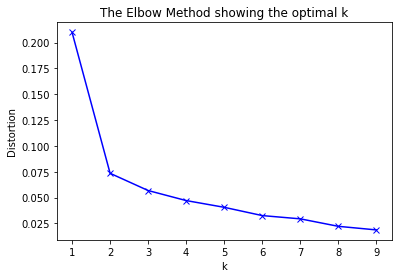

In [37]:
onehot_studios = pd.get_dummies(toronto_studios_data[['Venue Top Category']], prefix="", prefix_sep="")
onehot_studios['Neighbourhood'] = toronto_studios_data['Neighbourhood']
onehot_studios = onehot_studios[[onehot_studios.columns[-1]] + list(onehot_studios.columns[:-1])].groupby('Neighbourhood').mean().reset_index()

findOptimumK(onehot_studios.copy().drop('Neighbourhood', 1))

In [38]:
studio_clusters = 3
print('Optimum k is {} based on elbow method'.format(studio_clusters))
toronto_studio_clustering = onehot_studios.copy()
kmeans = KMeans(n_clusters=studio_clusters, random_state=0).fit(toronto_studio_clustering.drop('Neighbourhood', 1))
toronto_studio_clustering.insert(0, 'Cluster Labels', kmeans.labels_)
toronto_studio_clustering = toronto_studio_clustering.merge(toronto_demographics_data[['Neighbourhood', 'Lat', 'Lng']], how='left', on='Neighbourhood')
toronto_studio_clustering = toronto_studio_clustering[[toronto_studio_clustering.columns[1]] + list(toronto_studio_clustering.columns[-2:]) + [toronto_studio_clustering.columns[0]] + list(toronto_studio_clustering.columns[2:-2])]
toronto_studio_clustering.head()

Optimum k is 3 based on elbow method


,Neighbourhood,Lat,Lng,Cluster Labels,Gym / Fitness Center,Gymnastics Gym,Pilates Studio,Yoga Studio
0,Agincourt,43.797049,-79.266162,1,1.000000,0.000000,0.000000,0.000000
1,Alderwood,43.604937,-79.541611,1,1.000000,0.000000,0.000000,0.000000
2,Amesbury,43.701326,-79.485589,0,0.833333,0.000000,0.000000,0.166667
3,Banbury,43.737657,-79.349718,1,1.000000,0.000000,0.000000,0.000000
4,Bay Street Corridor,43.657511,-79.385721,1,0.901639,0.016393,0.016393,0.065574


In [39]:
rainbow = [colors.rgb2hex(i) for i in cm.rainbow(np.linspace(0, 1, studio_clusters))] # set color scheme for the clusters

map_toronto_clusters = folium.Map(location=toronto_location, zoom_start=11)
for lat, lon, poi, cluster in zip(toronto_studio_clustering['Lat'], toronto_studio_clustering['Lng'], toronto_studio_clustering['Neighbourhood'], toronto_studio_clustering['Cluster Labels']):
    label = folium.Popup(str(poi) + ', Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker([lat, lon], radius=5, popup=label, color=rainbow[cluster-1], fill=True).add_to(map_toronto_clusters)
map_toronto_clusters

In [40]:
rainbow = [colors.rgb2hex(i) for i in cm.rainbow(np.linspace(0, 1, studio_clusters))] # set color scheme for the clusters

map_toronto_clusters_with_studios = folium.Map(location=toronto_location, zoom_start=11)
a = toronto_studios_data[toronto_studios_data['Venue Category']=='Yoga Studio']
for lat, lng, name, cat in zip(a['Venue Lat'], a['Venue Lng'], a['Venue'], a['Venue Top Category']):
    label = folium.Popup('{},{}'.format(name, cat), parse_html=True)
    folium.CircleMarker([lat, lng], radius=5, popup=label, color=('yellow' if cat=='Yoga Studio' else 'green'), fill=True).add_to(map_toronto_clusters_with_studios)
a = toronto_studio_clustering #[toronto_studio_clustering['Cluster Labels']==0]
for lat, lon, poi, cluster in zip(a['Lat'], a['Lng'], a['Neighbourhood'], a['Cluster Labels']):
    label = folium.Popup(str(poi) + ', Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker([lat, lon], radius=5, popup=label, color=rainbow[cluster-1], fill=True).add_to(map_toronto_clusters_with_studios)
map_toronto_clusters_with_studios

**Similar Neighbourhoods For Venues** <a name="cl_venues"></a>

Identifying similiar neighbourhoods based on venues.

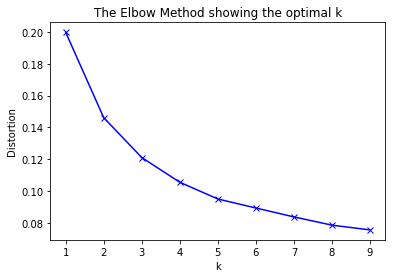

In [41]:
onehot_venues = pd.get_dummies(toronto_venues_data[['Venue Top Category']], prefix="", prefix_sep="")
onehot_venues['Neighbourhood'] = toronto_venues_data['Neighbourhood']
onehot_venues = onehot_venues[[onehot_venues.columns[-1]] + list(onehot_venues.columns[:-1])].groupby('Neighbourhood').mean().reset_index()

findOptimumK(onehot_venues.copy().drop('Neighbourhood', 1))

In [42]:
venue_clusters = 5
print('Optimum k is {} based on elbow method'.format(venue_clusters))
toronto_venue_clustering = onehot_venues.copy()
kmeans = KMeans(n_clusters=venue_clusters, random_state=0).fit(toronto_venue_clustering.drop('Neighbourhood', 1))
toronto_venue_clustering.insert(0, 'Cluster Labels', kmeans.labels_)
toronto_venue_clustering = toronto_venue_clustering.merge(toronto_demographics_data[['Neighbourhood', 'Lat', 'Lng']], how='left', on='Neighbourhood')
toronto_venue_clustering = toronto_venue_clustering[[toronto_venue_clustering.columns[1]] + list(toronto_venue_clustering.columns[-2:]) + [toronto_venue_clustering.columns[0]] + list(toronto_venue_clustering.columns[2:-2])]
toronto_venue_clustering.head()

Optimum k is 5 based on elbow method


,Neighbourhood,Lat,Lng,Cluster Labels,Nightlife Spot,Professional & Other Places,Residence,Shop & Service
0,Agincourt,43.797049,-79.266162,2,0.076923,0.192308,0.000000,0.730769
1,Alderwood,43.604937,-79.541611,1,0.114286,0.457143,0.057143,0.371429
2,Amesbury,43.701326,-79.485589,0,0.000000,0.363636,0.090909,0.545455
3,Banbury,43.737657,-79.349718,2,0.066667,0.226667,0.013333,0.693333
4,Bathurst Manor,43.764813,-79.456055,4,0.142857,0.571429,0.000000,0.285714


In [43]:
rainbow = [colors.rgb2hex(i) for i in cm.rainbow(np.linspace(0, 1, venue_clusters))] # set color scheme for the clusters

map_toronto_clusters = folium.Map(location=toronto_location, zoom_start=11)
for lat, lon, poi, cluster in zip(toronto_venue_clustering['Lat'], toronto_venue_clustering['Lng'], toronto_venue_clustering['Neighbourhood'], toronto_venue_clustering['Cluster Labels']):
    label = folium.Popup(str(poi) + ', Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker([lat, lon], radius=5, popup=label, color=rainbow[cluster-1], fill=True).add_to(map_toronto_clusters)
map_toronto_clusters

In [44]:
rainbow = [colors.rgb2hex(i) for i in cm.rainbow(np.linspace(0, 1, venue_clusters))] # set color scheme for the clusters

map_toronto_clusters_with_venues = folium.Map(location=toronto_location, zoom_start=11)
a = toronto_venues_data
for lat, lng, name, cat in zip(a['Venue Lat'], a['Venue Lng'], a['Venue'], a['Venue Top Category']):
    label = folium.Popup('{},{}'.format(name, cat), parse_html=True)
    folium.CircleMarker([lat, lng], radius=5, popup=label, color=('yellow' if cat=='Yoga Studio' else 'green'), fill=True).add_to(map_toronto_clusters_with_venues)
a = toronto_venue_clustering #[toronto_venue_clustering['Cluster Labels']==0]
for lat, lon, poi, cluster in zip(a['Lat'], a['Lng'], a['Neighbourhood'], a['Cluster Labels']):
    label = folium.Popup(str(poi) + ', Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker([lat, lon], radius=5, popup=label, color=rainbow[cluster-1], fill=True).add_to(map_toronto_clusters_with_venues)
map_toronto_clusters_with_venues

**Similar Neighbourhoods For Studios and Venues Combined** <a name="cl_combined"></a>

Identifying similiar neighbourhoods based on studios and venues combined.

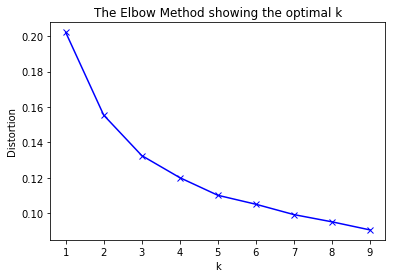

In [45]:
toronto_combined_data = toronto_studios_data.append(toronto_venues_data)
onehot_combined = pd.get_dummies(toronto_combined_data[['Venue Top Category']], prefix="", prefix_sep="")
onehot_combined['Neighbourhood'] = toronto_combined_data['Neighbourhood']
onehot_combined = onehot_combined[[onehot_combined.columns[-1]] + list(onehot_combined.columns[:-1])].groupby('Neighbourhood').mean().reset_index()

findOptimumK(onehot_combined.copy().drop('Neighbourhood', 1))

In [46]:
combined_clusters = 5
print('Optimum k is {} based on elbow method'.format(combined_clusters))
toronto_combined_clustering = onehot_combined.copy()
kmeans = KMeans(n_clusters=combined_clusters, random_state=0).fit(toronto_combined_clustering.drop('Neighbourhood', 1))
toronto_combined_clustering.insert(0, 'Cluster Labels', kmeans.labels_)
toronto_combined_clustering = toronto_combined_clustering.merge(toronto_demographics_data[['Neighbourhood', 'Lat', 'Lng']], how='left', on='Neighbourhood')
toronto_combined_clustering = toronto_combined_clustering[[toronto_combined_clustering.columns[1]] + list(toronto_combined_clustering.columns[-2:]) + [toronto_combined_clustering.columns[0]] + list(toronto_combined_clustering.columns[2:-2])]
toronto_combined_clustering.head()

Optimum k is 5 based on elbow method


,Neighbourhood,Lat,Lng,Cluster Labels,Gym / Fitness Center,Gymnastics Gym,Nightlife Spot,Pilates Studio,Professional & Other Places,Residence,Shop & Service,Yoga Studio
0,Agincourt,43.797049,-79.266162,1,0.133333,0.0,0.066667,0.0,0.166667,0.000000,0.633333,0.000000
1,Alderwood,43.604937,-79.541611,3,0.102564,0.0,0.102564,0.0,0.410256,0.051282,0.333333,0.000000
2,Amesbury,43.701326,-79.485589,3,0.294118,0.0,0.000000,0.0,0.235294,0.058824,0.352941,0.058824
3,Banbury,43.737657,-79.349718,1,0.025974,0.0,0.064935,0.0,0.220779,0.012987,0.675325,0.000000
4,Bathurst Manor,43.764813,-79.456055,0,0.000000,0.0,0.142857,0.0,0.571429,0.000000,0.285714,0.000000


In [47]:
rainbow = [colors.rgb2hex(i) for i in cm.rainbow(np.linspace(0, 1, combined_clusters))] # set color scheme for the clusters

map_toronto_clusters = folium.Map(location=toronto_location, zoom_start=11)
for lat, lon, poi, cluster in zip(toronto_combined_clustering['Lat'], toronto_combined_clustering['Lng'], toronto_combined_clustering['Neighbourhood'], toronto_combined_clustering['Cluster Labels']):
    label = folium.Popup(str(poi) + ', Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker([lat, lon], radius=5, popup=label, color=rainbow[cluster-1], fill=True).add_to(map_toronto_clusters)
map_toronto_clusters

In [48]:
rainbow = [colors.rgb2hex(i) for i in cm.rainbow(np.linspace(0, 1, combined_clusters))] # set color scheme for the clusters

map_toronto_clusters_with_combined = folium.Map(location=toronto_location, zoom_start=11)
a = toronto_venues_data
for lat, lng, name, cat in zip(a['Venue Lat'], a['Venue Lng'], a['Venue'], a['Venue Top Category']):
    label = folium.Popup('{},{}'.format(name, cat), parse_html=True)
    folium.CircleMarker([lat, lng], radius=5, popup=label, color=('yellow' if cat=='Yoga Studio' else 'green'), fill=True).add_to(map_toronto_clusters_with_combined)
a = toronto_studios_data #[toronto_studios_data['Venue Category']=='Yoga Studio']
for lat, lng, name, cat in zip(a['Venue Lat'], a['Venue Lng'], a['Venue'], a['Venue Top Category']):
    label = folium.Popup('{},{}'.format(name, cat), parse_html=True)
    folium.CircleMarker([lat, lng], radius=5, popup=label, color=('yellow' if cat=='Yoga Studio' else 'green'), fill=True).add_to(map_toronto_clusters_with_combined)
a = toronto_combined_clustering #[toronto_venue_clustering['Cluster Labels']==0]
for lat, lon, poi, cluster in zip(a['Lat'], a['Lng'], a['Neighbourhood'], a['Cluster Labels']):
    label = folium.Popup(str(poi) + ', Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker([lat, lon], radius=5, popup=label, color=rainbow[cluster-1], fill=True).add_to(map_toronto_clusters_with_combined)
map_toronto_clusters_with_combined

## Results <a name="results"></a>

Visualizing clusters along with yoga studios.

In [49]:
rainbow = [colors.rgb2hex(i) for i in cm.rainbow(np.linspace(0, 1, venue_clusters))] # set color scheme for the clusters

map_toronto_clusters_combined = folium.Map(location=toronto_location, zoom_start=11)
a = toronto_studios_data[toronto_studios_data['Venue Category']=='Yoga Studio']
for lat, lng, name, cat in zip(a['Venue Lat'], a['Venue Lng'], a['Venue'], a['Venue Category']):
    label = folium.Popup('{},{}'.format(name, cat), parse_html=True)
    folium.CircleMarker([lat, lng], radius=5, popup=label, color=('yellow' if cat=='Yoga Studio' else 'green'), fill=True).add_to(map_toronto_clusters_combined)
a = toronto_combined_clustering #[toronto_combined_clustering['Cluster Labels']==0]
for lat, lon, poi, cluster in zip(a['Lat'], a['Lng'], a['Neighbourhood'], a['Cluster Labels']):
    label = folium.Popup(str(poi) + ', Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker([lat, lon], radius=5, popup=label, color=rainbow[cluster-1], fill=True).add_to(map_toronto_clusters_combined)
map_toronto_clusters_combined

By visualizing the combined clusters and the density of yoga studios overlapping with those clusters above, Cluster 2 and Cluster 3 have higher concentration of yoga studios compared to other clusters. Hence, assuming the business is able to develop in those neighbourhood, opening a yoga studio in one of these clusters will have a higher success rate.

Check number of places and their density per cluster.

In [50]:
onehot_studios2 = pd.get_dummies(toronto_studios_data[['Venue Top Category']], prefix="", prefix_sep="")
onehot_studios2['Neighbourhood'] = toronto_studios_data['Neighbourhood']
onehot_studios2 = onehot_studios2[[onehot_studios2.columns[-1]] + list(onehot_studios2.columns[:-1])].groupby('Neighbourhood').sum().reset_index()

onehot_venues2 = pd.get_dummies(toronto_venues_data[['Venue Top Category']], prefix="", prefix_sep="")
onehot_venues2['Neighbourhood'] = toronto_venues_data['Neighbourhood']
onehot_venues2 = onehot_venues2[[onehot_venues2.columns[-1]] + list(onehot_venues2.columns[:-1])].groupby('Neighbourhood').sum().reset_index().sort_values('Neighbourhood')

temp = toronto_combined_clustering[['Cluster Labels', 'Neighbourhood']].merge(onehot_studios2, on='Neighbourhood').merge(onehot_venues2, on='Neighbourhood').groupby('Cluster Labels')
cluster_count = temp.sum()
cluster_density = temp.mean().apply(lambda x: round(x,2))
del onehot_studios2, onehot_venues2, temp # no need for these variables anymore

In [51]:
print('Number of studios / venues per cluster:')
cluster_count.head()

Number of studios / venues per cluster:


,Gym / Fitness Center,Gymnastics Gym,Pilates Studio,Yoga Studio,Nightlife Spot,Professional & Other Places,Residence,Shop & Service
Cluster Labels,,,,,,,,
0,39.0,2.0,2.0,5.0,17.0,227.0,20.0,122.0
1,59.0,0.0,0.0,8.0,47.0,207.0,26.0,750.0
2,151.0,1.0,12.0,57.0,331.0,555.0,73.0,1005.0
3,169.0,1.0,2.0,30.0,247.0,441.0,95.0,434.0
4,12.0,0.0,1.0,1.0,13.0,110.0,10.0,143.0


In [52]:
print('Density of studios / venues per cluster:')
cluster_density.head()

Density of studios / venues per cluster:


,Gym / Fitness Center,Gymnastics Gym,Pilates Studio,Yoga Studio,Nightlife Spot,Professional & Other Places,Residence,Shop & Service
Cluster Labels,,,,,,,,
0,3.25,0.17,0.17,0.42,1.42,18.92,1.67,10.17
1,3.28,0.00,0.00,0.44,2.61,11.50,1.44,41.67
2,5.81,0.04,0.46,2.19,12.73,21.35,2.81,38.65
3,8.45,0.05,0.10,1.50,12.35,22.05,4.75,21.70
4,1.71,0.00,0.14,0.14,1.86,15.71,1.43,20.43


Considering only clusters 2 and 3 as they seem to have a higher density of yoga studios.

In [53]:
rainbow = [colors.rgb2hex(i) for i in cm.rainbow(np.linspace(0, 1, venue_clusters))] # set color scheme for the clusters

map_toronto_clusters_combined = folium.Map(location=toronto_location, zoom_start=11)
a = toronto_studios_data[toronto_studios_data['Venue Category']=='Yoga Studio']
for lat, lng, name, cat in zip(a['Venue Lat'], a['Venue Lng'], a['Venue'], a['Venue Category']):
    label = folium.Popup('{},{}'.format(name, cat), parse_html=True)
    folium.CircleMarker([lat, lng], radius=5, popup=label, color=('yellow' if cat=='Yoga Studio' else 'green'), fill=True).add_to(map_toronto_clusters_combined)
a = toronto_combined_clustering[toronto_combined_clustering['Cluster Labels']%4>1]
for lat, lon, poi, cluster in zip(a['Lat'], a['Lng'], a['Neighbourhood'], a['Cluster Labels']):
    label = folium.Popup(str(poi) + ', Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker([lat, lon], radius=5, popup=label, color=rainbow[cluster-1], fill=True).add_to(map_toronto_clusters_combined)
map_toronto_clusters_combined

In both Cluster 2 and Cluster 3, most of the yoga studios are concentrated in downtown Toronto and the market is more saturated. However, there are some untapped neighbourhoods available outside of downtown which makes those neighbourhoods a good candidate for a new yoga studio.

In [54]:
rainbow = [colors.rgb2hex(i) for i in cm.rainbow(np.linspace(0, 1, venue_clusters))] # set color scheme for the clusters

map_toronto_clusters_combined = folium.Map(location=toronto_location, zoom_start=11)
a = toronto_studios_data[toronto_studios_data['Venue Category']=='Yoga Studio']
for lat, lng, name, cat in zip(a['Venue Lat'], a['Venue Lng'], a['Venue'], a['Venue Category']):
    label = folium.Popup('{},{}'.format(name, cat), parse_html=True)
    folium.CircleMarker([lat, lng], radius=5, popup=label, color=('yellow' if cat=='Yoga Studio' else 'green'), fill=True).add_to(map_toronto_clusters_combined)
folium.CircleMarker([43.6882415644, -79.4939861445], radius=20, color='red', fill=True).add_to(map_toronto_clusters_combined)
a = toronto_combined_clustering[toronto_combined_clustering['Cluster Labels']%4>1]
for lat, lon, poi, cluster in zip(a['Lat'], a['Lng'], a['Neighbourhood'], a['Cluster Labels']):
    label = folium.Popup(str(poi) + ', Cluster ' + str(cluster) + ' ' + str(lat) + str(lon), parse_html=True)
    folium.CircleMarker([lat, lon], radius=5, popup=label, color=rainbow[cluster-1], fill=True).add_to(map_toronto_clusters_combined)
map_toronto_clusters_combined

As seen on the map, most of the yoga studios are nearby Cluster 2 neighbourhoods, and red marked two neighbourhoods is a good candidate for a new yoga studio since they share a lot of similar features where yoga studios are concentrated and since two neighbourhoods are close to each other which attract customers from both neighbourhoods.

## Discussion <a name="discussion"></a>

Toronto is a large city with 140 neighbourhoods. Due to the inconsistency of coordinate dataset and demographics dataset, only a subset of those neighbourhoods captured. Improving the consistency may result in different clusters and hence different results.

During the feature selection, some features are not included such as population of the neighbourhoods or the average income. Including more features that improves the clustering algorithm is a good addition to improve the overall recommendation. It’s also important not to introduce a lot of features that are overlapping since they tend to skew the clusters.

## Conclusion <a name="conclusion"></a>

In this report, neighbourhoods of Toronto are analysed with the goal of identifying best fitting neighbourhoods that are favourable opening a yoga studio. Clustering models are used in order to find similar neighbourhoods and then compared to the existing yoga studios overlapping with those clusters. The models and methodology can be useful to identify the best neighbourhood for a yoga studio but also can be enhanced or modified to identify other categories based on the needs.